X_Minimum: 결함이 있는 영역의 X 좌표 중 최소값 -> Area 만들고 제거<br>
X_Maximum: 결함이 있는 영역의 X 좌표 중 최대값 -> Area 만들고 제거<br>
Y_Minimum: 결함이 있는 영역의 Y 좌표 중 최소값 -> Area 만들고 제거<br>
Y_Maximum: 결함이 있는 영역의 Y 좌표 중 최대값 -> Area 만들고 제거<br>
Area : 위의 4가지를 조합해서 새로만든 컬럼 'Area'<br>
**너비 공식**<br>
**(df['X_Maximum'] - df['X_Minimum']) * (df['Y_Maximum'] - df['Y_Minimum'])<br>**<br>
Pixels_Areas: 결함이 있는 영역의 픽셀 면적<br>
X_Perimeter: 결함이 있는 영역의 X 방향 둘레 길이<br>
Y_Perimeter: 결함이 있는 영역의 Y 방향 둘레 길이<br>
Sum_of_Luminosity: 결함 영역의 픽셀 밝기 합계<br>
Minimum_of_Luminosity: 결함 영역 내 최소 픽셀 밝기<br>
Maximum_of_Luminosity: 결함 영역 내 최대 픽셀 밝기<br>
Length_of_Conveyer: 컨베이어의 길이<br>
TypeOfSteel_A300: 강철 유형 A300 여부 (이진 변수)<br>
TypeOfSteel_A400: 강철 유형 A400 여부 (이진 변수)<br>
TypeOfSteel : 0은 A300, 1은 A400 (전처리를 통해 이진 변수이므로 바꿈)<br>
Steel_Plate_Thickness: 강철판 두께<br>
Edges_Index: 결함 영역 내 가장자리의 인덱스<br>
Empty_Index: 결함 영역 내 빈 공간의 인덱스<br>
Square_Index: 결함 영역이 정사각형인지를 나타내는 인덱스<br>
Outside_X_Index: 결함 영역이 X 방향 바깥쪽에 위치한 비율<br>
Edges_X_Index: 결함 영역 내 X 방향 가장자리의 인덱스<br>
Edges_Y_Index: 결함 영역 내 Y 방향 가장자리의 인덱스<br>
Outside_Global_Index: 결함 영역이 전체 영역에서 X와 Y 방향 바깥쪽에 위치한 비율<br>
LogOfAreas: 결함 영역의 픽셀 면적에 대한 로그값<br>
Log_X_Index: 결함 영역의 X 좌표에 대한 로그값 -> 제거<br>
Log_Y_Index: 결함 영역의 Y 좌표에 대한 로그값 -> 제거<br>
Orientation_Index: 결함 영역의 방향 인덱스<br>
Luminosity_Index: 결함 영역의 밝기 인덱스<br>
SigmoidOfAreas: 결함 영역의 픽셀 면적에 대한 시그모이드 값 -> 특성중요도 기반 제거 예정<br>
Type: 강철판 결함의 종류 (다중 분류를 위한 목표 변수) -> 이것도 원핫인코딩 형태를 하나의 컬럼으로 정의하고 라벨인코딩 실시

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.svm import SVC

In [2]:
# 모든 컬럼을 출력할 수 있도록 설정
pd.set_option('display.max_columns', None)

path = '../../../data/steel.csv'

df = pd.read_csv(path)
df.head()

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,42,50,270900,270944,267,17,44,24220,76,108,1687,1,0,80,0.0498,0.2415,0.1818,0.0047,0.4706,1.0000,1.0,2.4265,0.9031,1.6435,0.8182,-0.2913,0.5822,1,0,0,0,0,0,0
1,645,651,2538079,2538108,108,10,30,11397,84,123,1687,1,0,80,0.7647,0.3793,0.2069,0.0036,0.6000,0.9667,1.0,2.0334,0.7782,1.4624,0.7931,-0.1756,0.2984,1,0,0,0,0,0,0
2,829,835,1553913,1553931,71,8,19,7972,99,125,1623,1,0,100,0.9710,0.3426,0.3333,0.0037,0.7500,0.9474,1.0,1.8513,0.7782,1.2553,0.6667,-0.1228,0.2150,1,0,0,0,0,0,0
3,853,860,369370,369415,176,13,45,18996,99,126,1353,0,1,290,0.7287,0.4413,0.1556,0.0052,0.5385,1.0000,1.0,2.2455,0.8451,1.6532,0.8444,-0.1568,0.5212,1,0,0,0,0,0,0
4,1289,1306,498078,498335,2409,60,260,246930,37,126,1353,0,1,185,0.0695,0.4486,0.0662,0.0126,0.2833,0.9885,1.0,3.3818,1.2305,2.4099,0.9338,-0.1992,1.0000,1,0,0,0,0,0,0


In [3]:
# 데이터프레임 정보 확인(결측치없음)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1941 entries, 0 to 1940
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   X_Minimum              1941 non-null   int64  
 1   X_Maximum              1941 non-null   int64  
 2   Y_Minimum              1941 non-null   int64  
 3   Y_Maximum              1941 non-null   int64  
 4   Pixels_Areas           1941 non-null   int64  
 5   X_Perimeter            1941 non-null   int64  
 6   Y_Perimeter            1941 non-null   int64  
 7   Sum_of_Luminosity      1941 non-null   int64  
 8   Minimum_of_Luminosity  1941 non-null   int64  
 9   Maximum_of_Luminosity  1941 non-null   int64  
 10  Length_of_Conveyer     1941 non-null   int64  
 11  TypeOfSteel_A300       1941 non-null   int64  
 12  TypeOfSteel_A400       1941 non-null   int64  
 13  Steel_Plate_Thickness  1941 non-null   int64  
 14  Edges_Index            1941 non-null   float64
 15  Empt

In [4]:
# 중복 확인
df.duplicated().sum()

0

In [5]:
df['Outside_Global_Index'].value_counts()

1.0    1072
0.0     778
0.5      91
Name: Outside_Global_Index, dtype: int64

In [6]:
df.describe()

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
count,1941.000000,1941.000000,1.941000e+03,1.941000e+03,1941.000000,1941.000000,1941.000000,1.941000e+03,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000,1941.000000
mean,571.136012,617.964451,1.650685e+06,1.650739e+06,1893.878413,111.855229,82.965997,2.063121e+05,84.548686,130.193715,1459.160227,0.400309,0.599691,78.737764,0.331715,0.414203,0.570767,0.033361,0.610529,0.813472,0.575734,2.492388,1.335686,1.403271,0.083288,-0.131305,0.585420,0.081401,0.097888,0.201443,0.037094,0.028336,0.207110,0.346728
std,520.690671,497.627410,1.774578e+06,1.774590e+06,5168.459560,301.209187,426.482879,5.122936e+05,32.134276,18.690992,144.577823,0.490087,0.490087,55.086032,0.299712,0.137261,0.271058,0.058961,0.243277,0.234274,0.482352,0.788930,0.481612,0.454345,0.500868,0.148767,0.339452,0.273521,0.297239,0.401181,0.189042,0.165973,0.405339,0.476051
min,0.000000,4.000000,6.712000e+03,6.724000e+03,2.000000,2.000000,1.000000,2.500000e+02,0.000000,37.000000,1227.000000,0.000000,0.000000,40.000000,0.000000,0.000000,0.008300,0.001500,0.014400,0.048400,0.000000,0.301000,0.301000,0.000000,-0.991000,-0.998900,0.119000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,51.000000,192.000000,4.712530e+05,4.712810e+05,84.000000,15.000000,13.000000,9.522000e+03,63.000000,124.000000,1358.000000,0.000000,0.000000,40.000000,0.060400,0.315800,0.361300,0.006600,0.411800,0.596800,0.000000,1.924300,1.000000,1.079200,-0.333300,-0.195000,0.248200,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,435.000000,467.000000,1.204128e+06,1.204136e+06,174.000000,26.000000,25.000000,1.920200e+04,90.000000,127.000000,1364.000000,0.000000,1.000000,70.000000,0.227300,0.412100,0.555600,0.010100,0.636400,0.947400,1.000000,2.240600,1.176100,1.322200,0.095200,-0.133000,0.506300,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1053.000000,1072.000000,2.183073e+06,2.183084e+06,822.000000,84.000000,83.000000,8.301100e+04,106.000000,140.000000,1650.000000,1.000000,1.000000,80.000000,0.573800,0.501600,0.818200,0.023500,0.800000,1.000000,1.000000,2.914900,1.518500,1.732400,0.511600,-0.066600,0.999800,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,1705.000000,1713.000000,1.298766e+07,1.298769e+07,152655.000000,10449.000000,18152.000000,1.159141e+07,203.000000,253.000000,1794.000000,1.000000,1.000000,300.000000,0.995200,0.943900,1.000000,0.875900,1.000000,1.000000,1.000000,5.183700,3.074100,4.258700,0.991700,0.642100,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


#### 이상치 확인 boxplot

##### Pixels_Areas, X_Perimeter, Y_Perimeter, Sum_of_Luminosity, Log_Y_Index

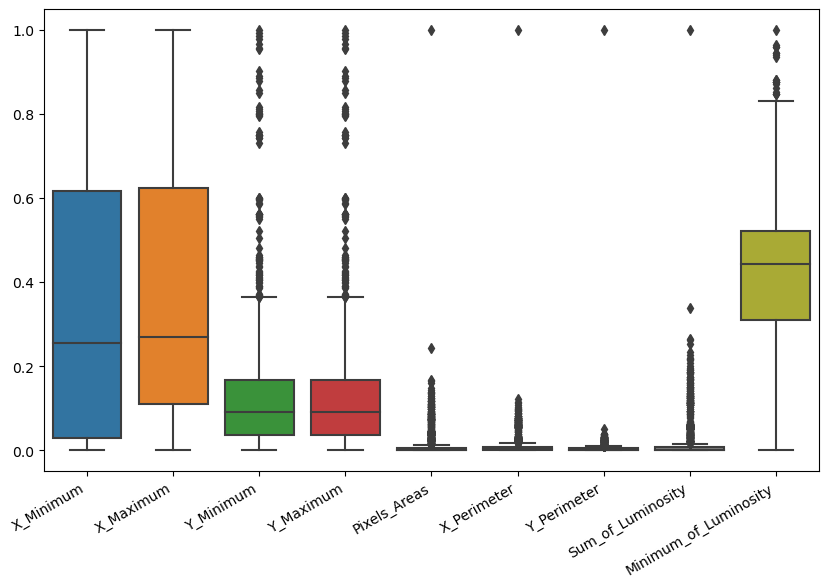

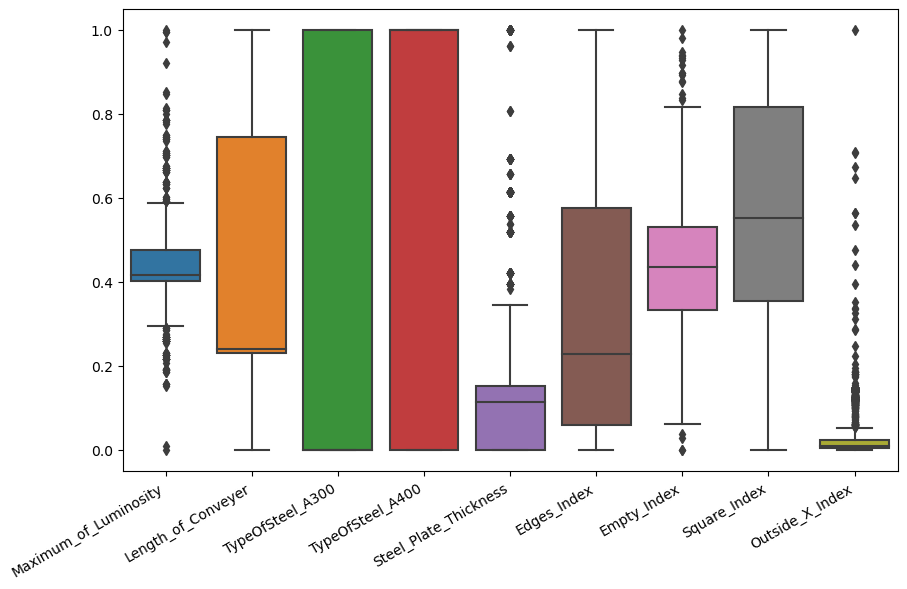

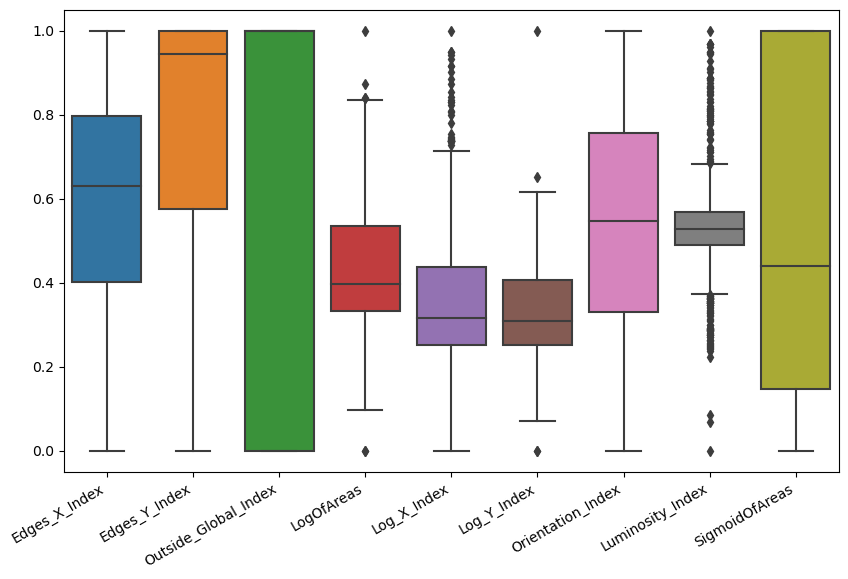

In [7]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

df_graph = df.copy()
df_graph = df_graph.iloc[:, :-7]
scaler = MinMaxScaler()
df_graph_scaler = scaler.fit_transform(df_graph)
df_graph_scaler = pd.DataFrame(df_graph_scaler, columns=df.columns[:-7])

# 그룹당 9개의 컬럼으로 나누어 박스플롯 그리기
num_groups = 3
cols_per_group = 9

for group in range(num_groups):
    start_idx = group * cols_per_group
    end_idx = (group + 1) * cols_per_group
    plt.figure(figsize=(10, 6))
    ax = sns.boxplot(data=df_graph_scaler.iloc[:, start_idx:end_idx])
    
    # x축 레이블의 각도 조절
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='right')
    
    # 그래프 저장하기
    plt.savefig(f"boxplot_group_{group+1}.png", bbox_inches='tight')
    plt.show()

##### Pixels_Areas, X_Perimeter, Y_Perimeter, Sum_of_Luminosity, Log_Y_Index

##### 특성공학 제거 Log_X_index, Log_Y_index

In [8]:
df.nlargest(5, 'Pixels_Areas') # 전체적으로 다 다른데이터들에 비해 큼(391번 인덱스)

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
391,19,169,4197607,4215748,152655,10449,18152,11591414,0,156,1336,0,1,40,0.0284,0.9439,0.0083,0.1123,0.0144,0.9994,1.0,5.1837,2.1761,4.2587,0.9917,-0.4068,1.0,0,0,1,0,0,0,0
1592,15,149,2278497,2278909,37334,908,903,3918209,19,134,1387,0,1,40,0.0216,0.3238,0.3252,0.0966,0.1476,0.4563,1.0,4.5721,2.1271,2.6149,0.6748,-0.1801,1.0,0,0,0,0,0,0,1
394,0,225,344016,344225,25473,992,578,3061597,23,148,1400,0,1,40,0.0000,0.4583,0.9289,0.1607,0.2268,0.3616,0.0,4.4061,2.3522,2.3201,-0.0711,-0.0610,1.0,0,0,1,0,0,0,0
392,0,230,308503,308712,25323,1022,593,3037459,24,148,1400,0,1,40,0.0000,0.4732,0.9087,0.1643,0.2251,0.3525,0.0,4.4035,2.3617,2.3201,-0.0913,-0.0629,1.0,0,0,1,0,0,0,0
395,0,436,407936,408170,24365,1084,680,2935414,22,143,1404,0,1,40,0.0000,0.7612,0.5367,0.3105,0.4022,0.3441,0.0,4.3868,2.6395,2.3692,-0.4633,-0.0588,1.0,0,0,1,0,0,0,0


In [9]:
df = df.drop(df.nlargest(1, 'Pixels_Areas').index)

In [10]:
df.nlargest(5, 'Pixels_Areas') # 위의 152655 Pixels_Areas 제거

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
1592,15,149,2278497,2278909,37334,908,903,3918209,19,134,1387,0,1,40,0.0216,0.3238,0.3252,0.0966,0.1476,0.4563,1.0,4.5721,2.1271,2.6149,0.6748,-0.1801,1.0,0,0,0,0,0,0,1
394,0,225,344016,344225,25473,992,578,3061597,23,148,1400,0,1,40,0.0000,0.4583,0.9289,0.1607,0.2268,0.3616,0.0,4.4061,2.3522,2.3201,-0.0711,-0.0610,1.0,0,0,1,0,0,0,0
392,0,230,308503,308712,25323,1022,593,3037459,24,148,1400,0,1,40,0.0000,0.4732,0.9087,0.1643,0.2251,0.3525,0.0,4.4035,2.3617,2.3201,-0.0913,-0.0629,1.0,0,0,1,0,0,0,0
395,0,436,407936,408170,24365,1084,680,2935414,22,143,1404,0,1,40,0.0000,0.7612,0.5367,0.3105,0.4022,0.3441,0.0,4.3868,2.6395,2.3692,-0.4633,-0.0588,1.0,0,0,1,0,0,0,0
398,1,222,486069,486291,22554,999,605,2712104,27,150,1400,0,1,40,0.0014,0.5403,0.9955,0.1579,0.2212,0.3669,1.0,4.3532,2.3444,2.3463,0.0045,-0.0606,1.0,0,0,1,0,0,0,0


#### 기존 Pixels_Areas 분포

#### log함수 씌운 Pixel_Areas 분포

In [11]:
df_sample = df.copy()
df_sample['Log_Pixels_Areas'] = np.log(df_sample['Pixels_Areas'])
df_sample = df_sample.drop(columns= 'Pixels_Areas')

In [12]:
# df_sample이라는 변수에 df_sample에 기존 Pixels_Areas 제거 drop사용하면 다시 돌릴때 에러가 자주 발생해서 바꿈
'''
df_sample = df_sample.loc[:, ~df_sample.columns.isin(['Pixels_Areas'])]
df_sample = df_sample.loc[:, ~df_sample.columns.isin(['Sum_of_Luminosity'])]
'''

"\ndf_sample = df_sample.loc[:, ~df_sample.columns.isin(['Pixels_Areas'])]\ndf_sample = df_sample.loc[:, ~df_sample.columns.isin(['Sum_of_Luminosity'])]\n"

##### TypeOfSteel_A300과 400이 0, 1이기때문에 하나를 제거하기로 함
##### 상관관계가 높기에 수식을 짜 하나의 컬럼으로 생성(다중공선성 해결방안)
##### 'Area' : (df['X_Maximum'] - df['X_Minimum']) * (df['Y_Maximum'] - df['Y_Minimum'])

In [13]:
# 일단 카피
df_clear = df.copy()
# 타겟특성 빼고 변수에 저장
df_clear = df_clear.drop(df.iloc[:,-7:].columns, axis=1)
# Area라는 컬럼 생성
df_clear['Area'] = (df['X_Maximum'] - df['X_Minimum']) * (df['Y_Maximum'] - df['Y_Minimum'])
# Area컬럼을 생성하는데 사용된 피쳐 제거(X_Maximum, X_Minimum, Y_Maximum, Y_Minimum)
df_clear = df_clear.drop(df.iloc[:, :4].columns, axis=1)
# A300 제거(300 or 400이라 하나 제거 후 컬럼명 어떻게 할지 고민)
df_clear = df_clear.drop('TypeOfSteel_A300', axis=1)
# 일단 TypeOfSteel로만 변경해서 설명란에 0은 300 1은 400으로 해보기로
df_clear.rename(columns={'TypeOfSteel_A400':'TypeOfSteel'}, inplace=True)
# Log_X_index, Log_Y_index 제거 LogOFAreas가 합친결과값으로 판단되어 제거하기로 함
df_clear = df_clear.drop(['Log_X_Index', 'Log_Y_Index'], axis=1)
df_clear.head()

,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Area
0,267,17,44,24220,76,108,1687,0,80,0.0498,0.2415,0.1818,0.0047,0.4706,1.0000,1.0,2.4265,0.8182,-0.2913,0.5822,352
1,108,10,30,11397,84,123,1687,0,80,0.7647,0.3793,0.2069,0.0036,0.6000,0.9667,1.0,2.0334,0.7931,-0.1756,0.2984,174
2,71,8,19,7972,99,125,1623,0,100,0.9710,0.3426,0.3333,0.0037,0.7500,0.9474,1.0,1.8513,0.6667,-0.1228,0.2150,108
3,176,13,45,18996,99,126,1353,1,290,0.7287,0.4413,0.1556,0.0052,0.5385,1.0000,1.0,2.2455,0.8444,-0.1568,0.5212,315
4,2409,60,260,246930,37,126,1353,1,185,0.0695,0.4486,0.0662,0.0126,0.2833,0.9885,1.0,3.3818,0.9338,-0.1992,1.0000,4369


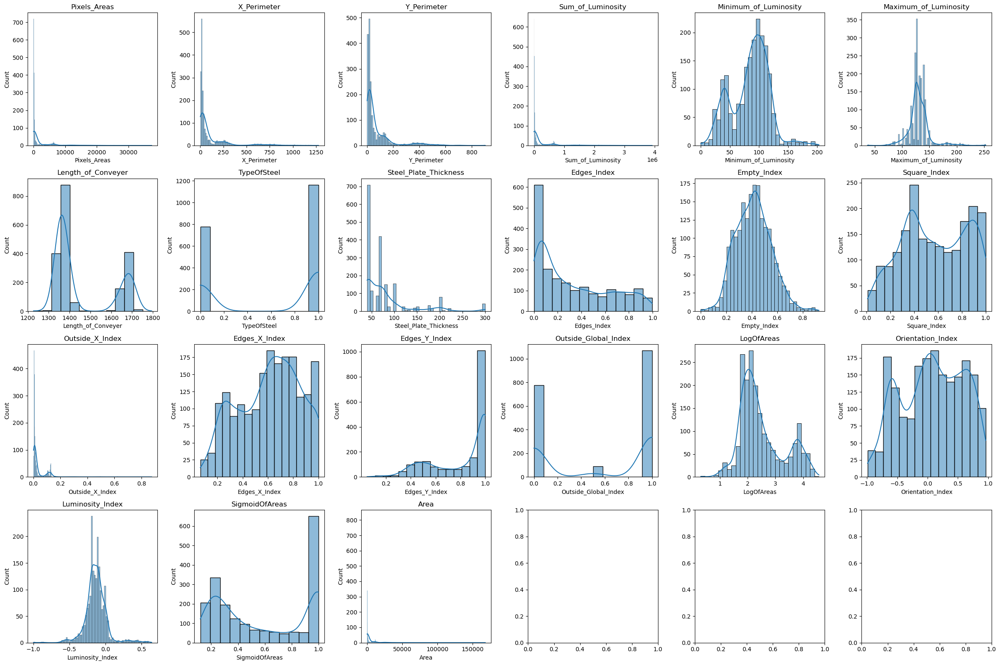

In [14]:
def plot_distribution(df):
    num_plots = len(df.columns)
    num_cols = 6
    num_rows = num_plots // num_cols if num_plots % num_cols == 0 else num_plots // num_cols + 1

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(num_cols*4, num_rows*4))

    for i, col in enumerate(df.columns):
        row = i // num_cols
        pos = i % num_cols
        sns.histplot(df[col], kde=True, ax=axs[row][pos])
        axs[row][pos].set_title(f'{col}')

    plt.tight_layout()
    plt.show()

plot_distribution(df_clear)

In [15]:
# 실험용 로그 적용한 파일

# 일단 카피
df_clear2 = df_sample.copy()

target_list = ['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']

# 타겟특성 빼고 변수에 저장
df_clear2 = df_clear2.drop(columns=target_list)
# Area라는 컬럼 생성
df_clear2['Area'] = (df['X_Maximum'] - df['X_Minimum']) * (df['Y_Maximum'] - df['Y_Minimum'])
# Area컬럼을 생성하는데 사용된 피쳐 제거(X_Maximum, X_Minimum, Y_Maximum, Y_Minimum)
df_clear2 = df_clear2.drop(df.iloc[:, :4].columns, axis=1)
# A300 제거(300 or 400이라 하나 제거 후 컬럼명 어떻게 할지 고민)
df_clear2 = df_clear2.drop('TypeOfSteel_A300', axis=1)
# 일단 TypeOfSteel로만 변경해서 설명란에 0은 300 1은 400으로 해보기로
df_clear2.rename(columns={'TypeOfSteel_A400':'TypeOfSteel'}, inplace=True)
# Log_X_index, Log_Y_index 제거 LogOFAreas가 합친결과값으로 판단되어 제거하기로 함
df_clear2 = df_clear2.drop(['Log_X_Index', 'Log_Y_Index'], axis=1)
df_clear2 = df_clear2.drop('Outside_Global_Index', axis=1)
df_clear2.head()

,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,LogOfAreas,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Log_Pixels_Areas,Area
0,17,44,24220,76,108,1687,0,80,0.0498,0.2415,0.1818,0.0047,0.4706,1.0000,2.4265,0.8182,-0.2913,0.5822,5.587249,352
1,10,30,11397,84,123,1687,0,80,0.7647,0.3793,0.2069,0.0036,0.6000,0.9667,2.0334,0.7931,-0.1756,0.2984,4.682131,174
2,8,19,7972,99,125,1623,0,100,0.9710,0.3426,0.3333,0.0037,0.7500,0.9474,1.8513,0.6667,-0.1228,0.2150,4.262680,108
3,13,45,18996,99,126,1353,1,290,0.7287,0.4413,0.1556,0.0052,0.5385,1.0000,2.2455,0.8444,-0.1568,0.5212,5.170484,315
4,60,260,246930,37,126,1353,1,185,0.0695,0.4486,0.0662,0.0126,0.2833,0.9885,3.3818,0.9338,-0.1992,1.0000,7.786967,4369


In [16]:
df_clear2.describe()

,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,LogOfAreas,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Log_Pixels_Areas,Area
count,1940.000000,1940.000000,1.940000e+03,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000,1940.000000
mean,106.526804,73.652062,2.004435e+05,84.592268,130.180412,1459.223711,0.599485,78.757732,0.331872,0.413930,0.571057,0.033320,0.610836,0.813376,2.491001,0.082819,-0.131163,0.585207,5.735743,4064.463402
std,188.775659,116.249962,4.423759e+05,32.085131,18.686619,144.588037,0.490129,55.093208,0.299710,0.136769,0.270827,0.058949,0.242963,0.234296,0.786762,0.500572,0.148674,0.339409,1.811586,11364.096187
min,2.000000,1.000000,2.500000e+02,0.000000,37.000000,1227.000000,0.000000,40.000000,0.000000,0.000000,0.009000,0.001500,0.064500,0.048400,0.301000,-0.991000,-0.998900,0.119000,0.693147,2.000000
25%,15.000000,13.000000,9.519500e+03,63.000000,124.000000,1358.000000,0.000000,40.000000,0.060400,0.315775,0.361525,0.006600,0.411800,0.596675,1.924300,-0.333300,-0.194850,0.247875,4.430817,135.750000
50%,26.000000,25.000000,1.919550e+04,90.000000,127.000000,1364.000000,1.000000,70.000000,0.227550,0.412050,0.556800,0.010100,0.636400,0.947400,2.239300,0.094900,-0.132900,0.506300,5.156173,306.000000
75%,84.000000,83.000000,8.267650e+04,106.000000,140.000000,1650.000000,1.000000,80.000000,0.574650,0.501300,0.818200,0.023425,0.800000,1.000000,2.910925,0.502900,-0.066575,0.999800,6.702560,1604.000000
max,1275.000000,903.000000,3.918209e+06,203.000000,253.000000,1794.000000,1.000000,300.000000,0.995200,0.927500,1.000000,0.875900,1.000000,1.000000,4.572100,0.960700,0.642100,1.000000,10.527660,168084.000000


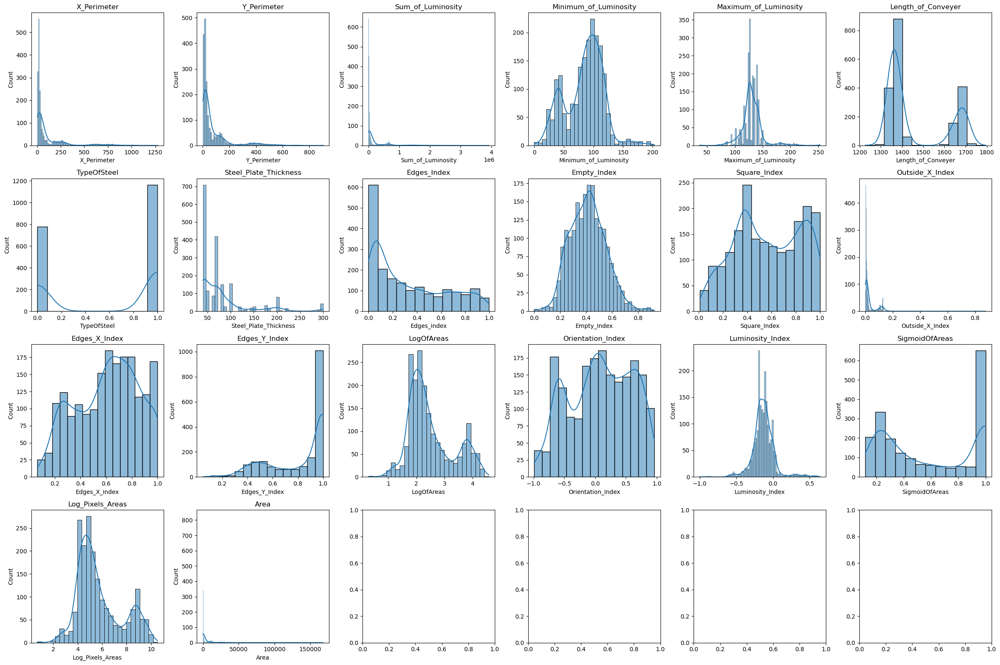

In [17]:
plot_distribution(df_clear2)

### Log 취할것
Right
X_Perimeter
Y_Perimeter
Steel_Plate_Thinkness
Sum_of_Luminosity
Outside_X_Index
Area

Left
Edges_Y_Index 

### 지수 취할 것
Edges_Index

두개로 나눈다


Log를 취하고 Edges_Index를 그대로 둔 경우, 왜인지 모르겠는데 'Sum_of_Luminosity'가 빠짐 - df_clear2


Log를 취하고 Edges_Index를 지수변환한 경우 - df_clear_exp

In [18]:
# 나머지 log 변환 - df_clear2

log_list = ['X_Perimeter',
'Y_Perimeter',
'Steel_Plate_Thickness',
'Outside_X_Index',
'Area',
'Sum_of_Luminosity',
'Edges_Y_Index',]

for i in log_list:
    df_clear2[i] = np.log(df_clear2[i])

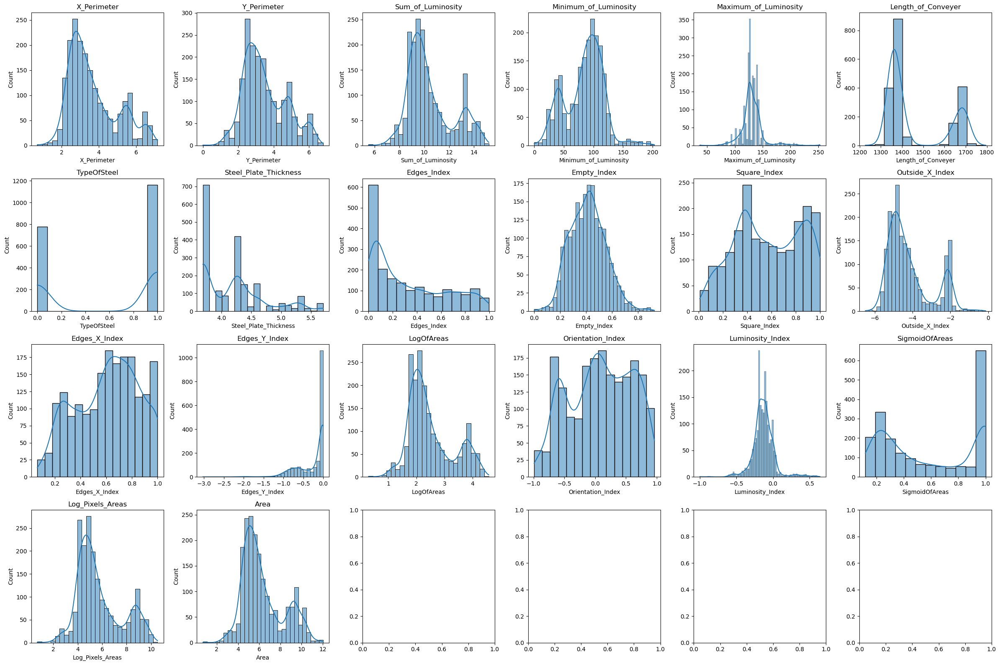

In [19]:
plot_distribution(df_clear2)

In [20]:
# Edges_Index 지수변환 - df_clear_exp
df_clear_exp = df_clear2.copy()

exp_list = ['Edges_Index']

for i in exp_list:
    df_clear_exp[i] = np.exp(df_clear_exp[i])

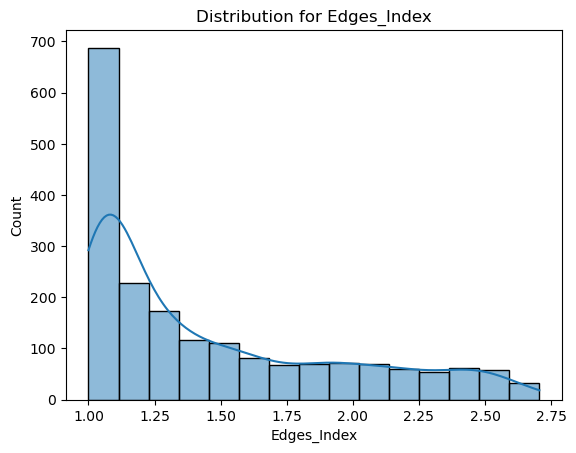

In [21]:
# Exp_Edgest_Index 분포 확인 
sns.histplot(df_clear_exp['Edges_Index'], kde=True)
plt.title('Distribution for Edges_Index')
plt.show()

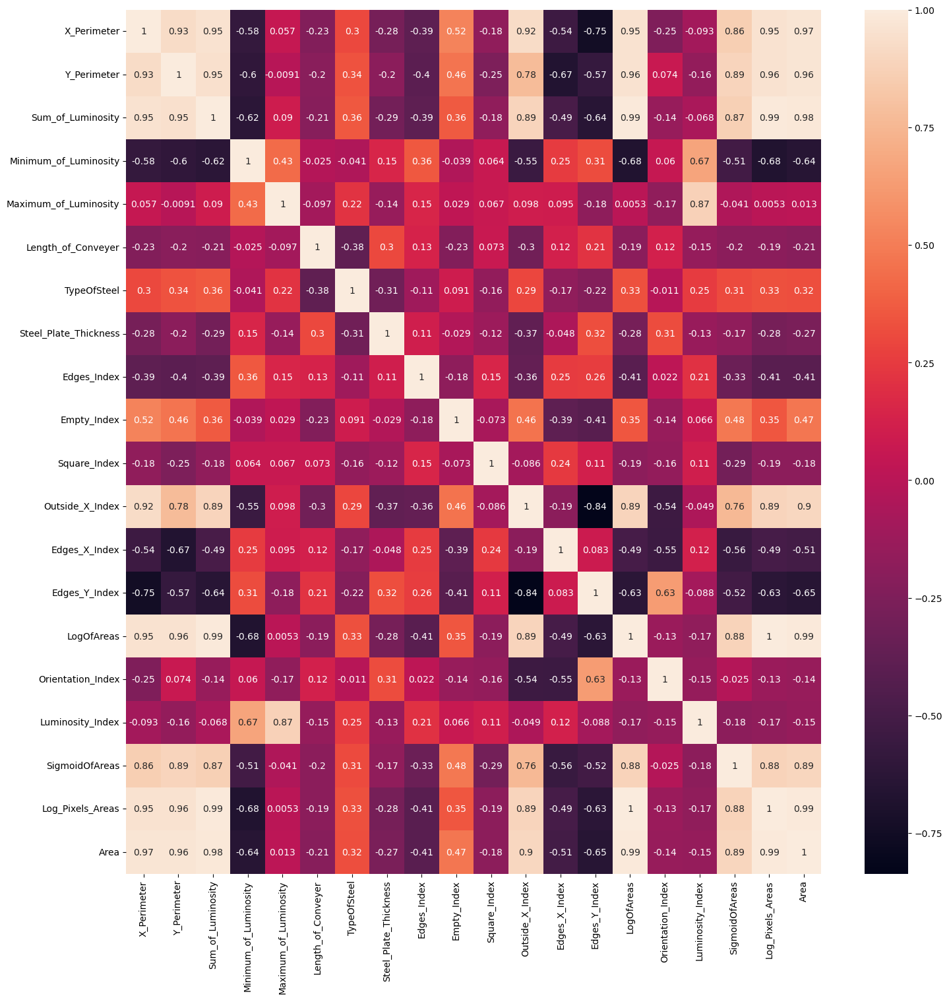

In [22]:
plt.figure(figsize=(17,17))
sns.heatmap(df_clear2.corr(),annot=True)
plt.show()

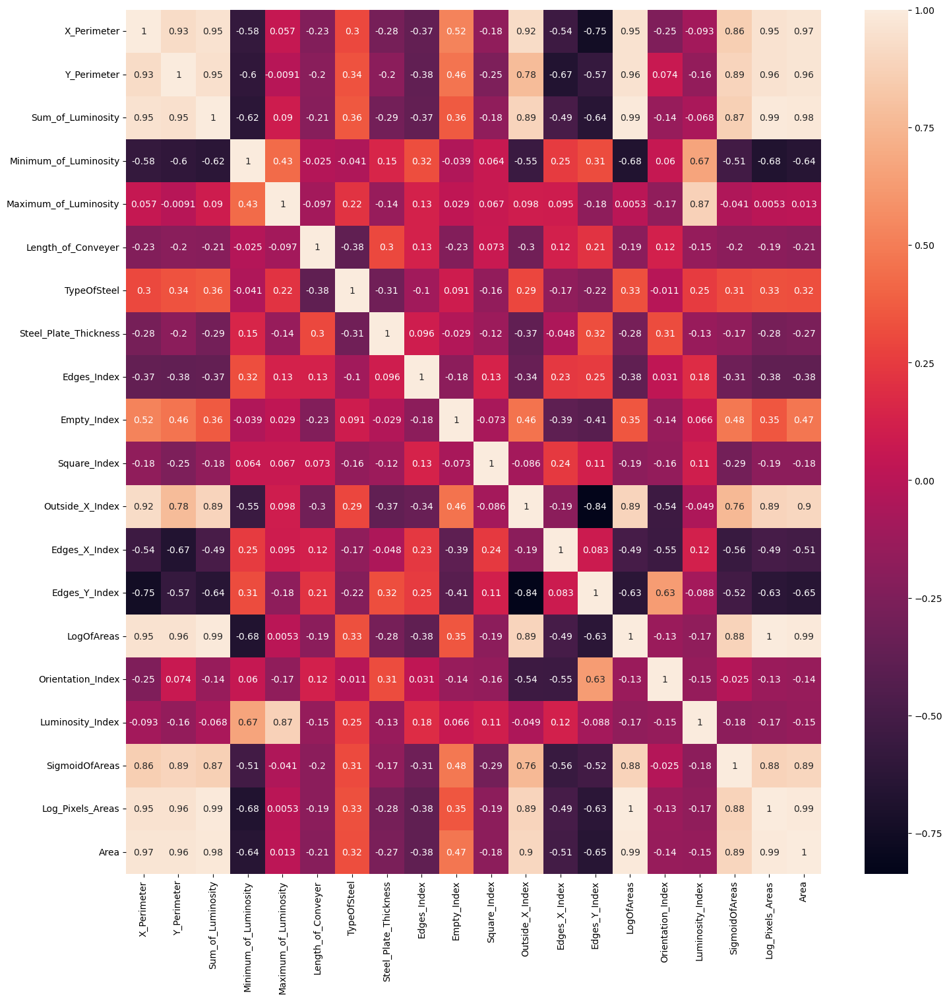

In [23]:
plt.figure(figsize=(17,17))
sns.heatmap(df_clear_exp.corr(),annot=True)
plt.show()

#### 실험

In [24]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

In [44]:
y_list = list(df.iloc[:,-7:].columns)
df_target = df.copy()
df_target["Type"] = df_target.loc[:,y_list][y_list].idxmax(axis=1)
df_target = df_target.drop(columns=y_list)
display(df_target['Type'].value_counts())
# 밑에 카운트플롯 그리는 용도
df_target_sorted = df_target['Type'].value_counts().reset_index()
df_target_sorted.columns = ['Type', 'Count']
df_target_sorted = df_target_sorted.sort_values(by='Count', ascending=False)

Other_Faults    673
Bumps           402
K_Scatch        390
Z_Scratch       190
Pastry          158
Stains           72
Dirtiness        55
Name: Type, dtype: int64

In [43]:
y_list = list(df.iloc[:,-7:].columns)
df_target = df.copy()
df_target["Type"] = df_target.loc[:,y_list][y_list].idxmax(axis=1)
df_target = df_target.drop(columns=y_list)


In [45]:
df_target

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Type
0,42,50,270900,270944,267,17,44,24220,76,108,1687,1,0,80,0.0498,0.2415,0.1818,0.0047,0.4706,1.0000,1.0,2.4265,0.9031,1.6435,0.8182,-0.2913,0.5822,Pastry
1,645,651,2538079,2538108,108,10,30,11397,84,123,1687,1,0,80,0.7647,0.3793,0.2069,0.0036,0.6000,0.9667,1.0,2.0334,0.7782,1.4624,0.7931,-0.1756,0.2984,Pastry
2,829,835,1553913,1553931,71,8,19,7972,99,125,1623,1,0,100,0.9710,0.3426,0.3333,0.0037,0.7500,0.9474,1.0,1.8513,0.7782,1.2553,0.6667,-0.1228,0.2150,Pastry
3,853,860,369370,369415,176,13,45,18996,99,126,1353,0,1,290,0.7287,0.4413,0.1556,0.0052,0.5385,1.0000,1.0,2.2455,0.8451,1.6532,0.8444,-0.1568,0.5212,Pastry
4,1289,1306,498078,498335,2409,60,260,246930,37,126,1353,0,1,185,0.0695,0.4486,0.0662,0.0126,0.2833,0.9885,1.0,3.3818,1.2305,2.4099,0.9338,-0.1992,1.0000,Pastry
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1936,249,277,325780,325796,273,54,22,35033,119,141,1360,0,1,40,0.3662,0.3906,0.5714,0.0206,0.5185,0.7273,0.0,2.4362,1.4472,1.2041,-0.4286,0.0026,0.7254,Other_Faults
1937,144,175,340581,340598,287,44,24,34599,112,133,1360,0,1,40,0.2118,0.4554,0.5484,0.0228,0.7046,0.7083,0.0,2.4579,1.4914,1.2305,-0.4516,-0.0582,0.8173,Other_Faults
1938,145,174,386779,386794,292,40,22,37572,120,140,1360,0,1,40,0.2132,0.3287,0.5172,0.0213,0.7250,0.6818,0.0,2.4654,1.4624,1.1761,-0.4828,0.0052,0.7079,Other_Faults
1939,137,170,422497,422528,419,97,47,52715,117,140,1360,0,1,40,0.2015,0.5904,0.9394,0.0243,0.3402,0.6596,0.0,2.6222,1.5185,1.4914,-0.0606,-0.0171,0.9919,Other_Faults


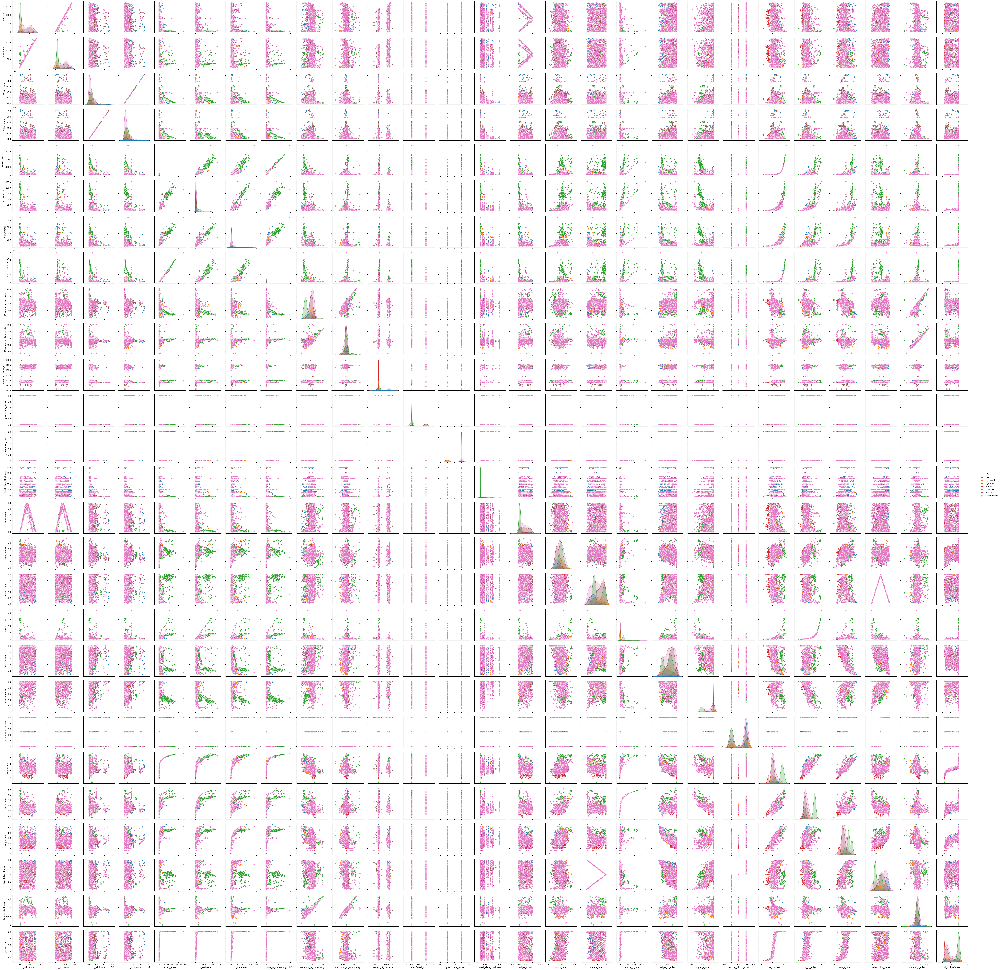

In [46]:
sns.pairplot(df_target, hue = 'Type')

In [ ]:
# 다중분류를 위한 'Type' 컬럼 값 수정
df_target2 = df_target.copy()
# 'Other_Faults'를 제외한 인덱스 가져오기
indices_to_remove = df_target2[df_target2['Type'] == 'Other_Faults'].index
# 해당 인덱스들을 제거하여 새로운 데이터프레임 생성
df_clear3 = df_clear2.copy()
df_clear3 = df_clear3.drop(indices_to_remove)
# 'Other_Faults' 행을 제외하고 결함이 있는 것만 남기기
df_target2 = df_target2[df_target2['Type'] != 'Other_Faults']
df_target2['Type'].value_counts(normalize=True)

Bumps        0.317285
K_Scatch     0.307814
Z_Scratch    0.149961
Pastry       0.124704
Stains       0.056827
Dirtiness    0.043410
Name: Type, dtype: float64

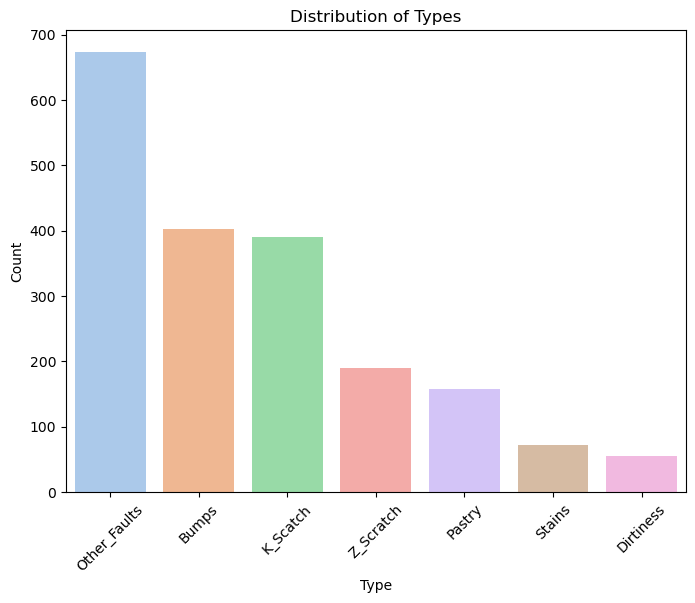

In [ ]:
# 카운트플롯 그리기
plt.figure(figsize=(8, 6))
sns.barplot(x='Type', y='Count', data=df_target_sorted, palette='pastel', order=df_target_sorted['Type'])
plt.title('Distribution of Types')
plt.xticks(rotation=45)  # X 축 라벨 회전
plt.show()

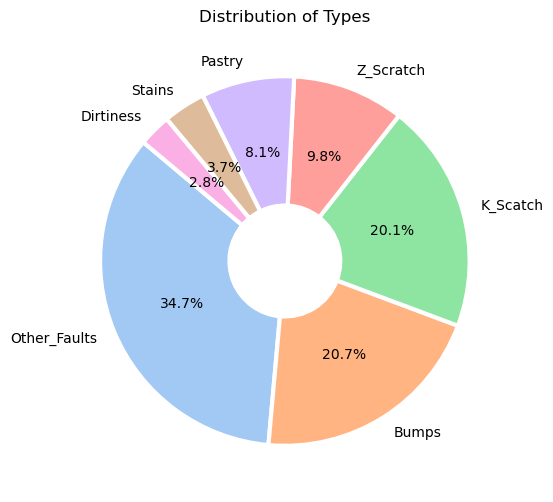

In [ ]:
# 파이 차트 그리기
plt.figure(figsize=(6, 6))
sns.set_palette("pastel")  # 색상 팔레트 지정
df_target['Type'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=140,
                                      wedgeprops=dict(width=0.7, linewidth=3, edgecolor='white'))
plt.title('Distribution of Types')
plt.ylabel('')  # y축 라벨 제거
plt.show()

In [ ]:
from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler

x = df_clear2
y = df_target1["Type"]

# 스케일링
scaler = StandardScaler()
x_scaler = scaler.fit_transform(x)
x_scaler = pd.DataFrame(x_scaler, columns=x.columns)

# 훈련
x_train, x_test, y_train, y_test = train_test_split(x_scaler, y, test_size=0.2)
# encoder = LabelEncoder()
# y_train, y_test = encoder.fit_transform(y_train), encoder.fit_transform(y_test)
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((1552, 20), (388, 20), (1552,), (388,))

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix

def get_metrics(model, X, y):
    y_pred=model.predict(X)
    
    Precision    = metrics.precision_score (y, y_pred, average="weighted")
    Recall       = metrics.recall_score    (y, y_pred, average="weighted")
    Accuracy     = metrics.accuracy_score  (y, y_pred)
    F1           = metrics.f1_score        (y, y_pred, average="weighted")
    
    print(f'Precision Score  : {Precision}')
    print(f'Recall Score     : {Recall}')
    print(f'Accuracy Score   : {Accuracy}')
    print(f'F1 Score         : {F1}')
    return Precision, Recall, Accuracy, F1, y_pred

In [ ]:
df_clear2

,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,LogOfAreas,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Log_Pixels_Areas,Area
0,2.833213,3.784190,10.094934,76,108,1687,0,4.382027,0.0498,0.2415,0.1818,-5.360193,0.4706,0.000000,2.4265,0.8182,-0.2913,0.5822,5.587249,5.863631
1,2.302585,3.401197,9.341105,84,123,1687,0,4.382027,0.7647,0.3793,0.2069,-5.626821,0.6000,-0.033867,2.0334,0.7931,-0.1756,0.2984,4.682131,5.159055
2,2.079442,2.944439,8.983691,99,125,1623,0,4.605170,0.9710,0.3426,0.3333,-5.599422,0.7500,-0.054034,1.8513,0.6667,-0.1228,0.2150,4.262680,4.682131
3,2.564949,3.806662,9.851984,99,126,1353,1,5.669881,0.7287,0.4413,0.1556,-5.259097,0.5385,0.000000,2.2455,0.8444,-0.1568,0.5212,5.170484,5.752573
4,4.094345,5.560682,12.416860,37,126,1353,1,5.220356,0.0695,0.4486,0.0662,-4.374058,0.2833,-0.011567,3.3818,0.9338,-0.1992,1.0000,7.786967,8.382289
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1936,3.988984,3.091042,10.464046,119,141,1360,1,3.688879,0.3662,0.3906,0.5714,-3.882464,0.5185,-0.318416,2.4362,-0.4286,0.0026,0.7254,5.609472,6.104793
1937,3.784190,3.178054,10.451580,112,133,1360,1,3.688879,0.2118,0.4554,0.5484,-3.780995,0.7046,-0.344888,2.4579,-0.4516,-0.0582,0.8173,5.659482,6.267201
1938,3.688879,3.091042,10.534014,120,140,1360,1,3.688879,0.2132,0.3287,0.5172,-3.849048,0.7250,-0.383019,2.4654,-0.4828,0.0052,0.7079,5.676754,6.075346
1939,4.574711,3.850148,10.872655,117,140,1360,1,3.688879,0.2015,0.5904,0.9394,-3.717279,0.3402,-0.416122,2.6222,-0.0606,-0.0171,0.9919,6.037871,6.930495


### 이진분류

In [ ]:
import time

model_rf = RandomForestClassifier()
start_time = time.time()
model_rf.fit(x_train, y_train)
end_time= time.time()
rf_precision_train, rf_recall_train, rf_accuracy_train, rf_f1_train, y_pred = get_metrics(model_rf, x_train, y_train)
print('실행시간 : ', end_time - start_time)
print('='*100)
rf_precision_test, rf_recall_test, rf_accuracy_test, rf_f1_test, y_pred = get_metrics(model_rf, x_test, y_test)

Precision Score  : 1.0
Recall Score     : 1.0
Accuracy Score   : 1.0
F1 Score         : 1.0
실행시간 :  0.366058349609375
Precision Score  : 0.8001466355923067
Recall Score     : 0.8041237113402062
Accuracy Score   : 0.8041237113402062
F1 Score         : 0.8002124628793549


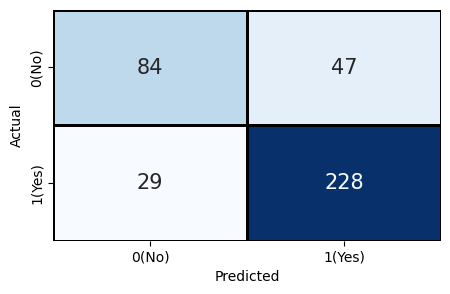

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

### 특성중요도 확인(전처리 추가해보기위해 실험)

In [ ]:
importances = model_rf.feature_importances_
importance_df = pd.DataFrame({'Feature': x_train.columns, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

In [ ]:
importance_df

,Feature,Importance
7,Steel_Plate_Thickness,0.090079
8,Edges_Index,0.070302
15,Orientation_Index,0.060385
11,Outside_X_Index,0.057092
5,Length_of_Conveyer,0.056994
2,Sum_of_Luminosity,0.056639
3,Minimum_of_Luminosity,0.053961
9,Empty_Index,0.053661
14,LogOfAreas,0.052561
16,Luminosity_Index,0.051915


### 특성중요도 이진분류 기준

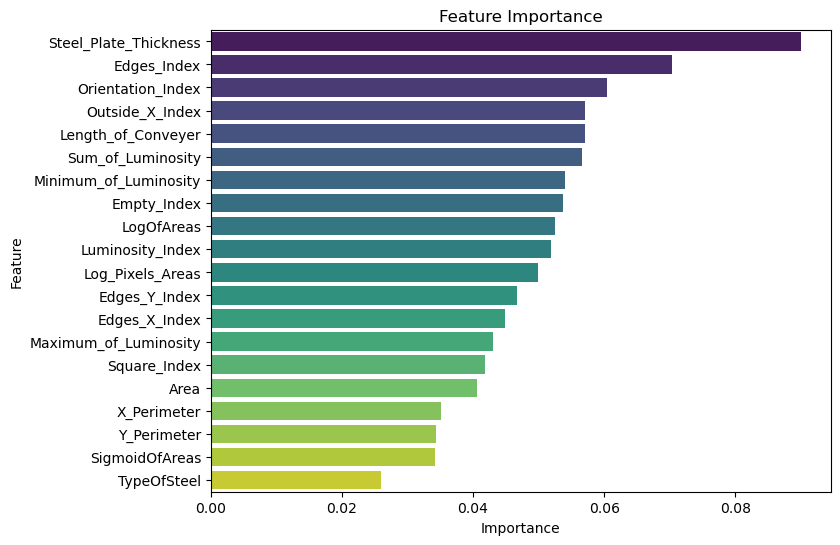

In [ ]:
# 막대 그래프 그리기
plt.figure(figsize=(8, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df, palette='viridis')
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

### 이진 로지스틱

In [ ]:
import time
from sklearn.linear_model import LogisticRegression

model_lr = LogisticRegression()
start_time = time.time()
model_lr.fit(x_train, y_train)
end_time= time.time()
lr_precision_train, lr_recall_train, lr_accuracy_train, lr_f1_train, y_pred = get_metrics(model_lr, x_train, y_train)
print('실행시간 : ', end_time - start_time)
print('='*100)
lr_precision_test, lr_recall_test, lr_accuracy_test, lr_f1_test, y_pred = get_metrics(model_lr, x_test, y_test)

Precision Score  : 0.7073382985370263
Recall Score     : 0.7177835051546392
Accuracy Score   : 0.7177835051546392
F1 Score         : 0.6968801262904396
실행시간 :  0.03295087814331055
Precision Score  : 0.7116330834114339
Recall Score     : 0.7242268041237113
Accuracy Score   : 0.7242268041237113
F1 Score         : 0.707797926210945


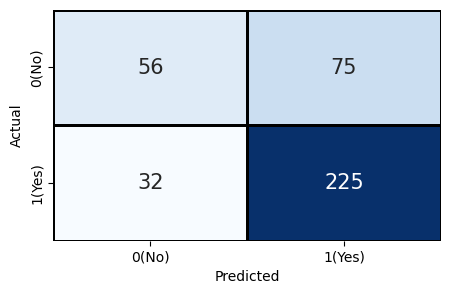

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler

x = df_clear2
y = df_target1["Type"]

# 스케일링
scaler = StandardScaler()
x_scaler = scaler.fit_transform(x)
x_scaler = pd.DataFrame(x_scaler, columns=x.columns)

# 훈련
x_train, x_test, y_train, y_test = train_test_split(x_scaler, y, test_size=0.2)
# encoder = LabelEncoder()
# y_train, y_test = encoder.fit_transform(y_train), encoder.fit_transform(y_test)
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((1552, 20), (388, 20), (1552,), (388,))

In [ ]:
import time

model_svc = SVC(kernel='poly')
start_time = time.time()
model_svc.fit(x_train, y_train)
end_time= time.time()
lr_precision_train, lr_recall_train, lr_accuracy_train, lr_f1_train, y_pred = get_metrics(model_svc, x_train, y_train)
print('실행시간 : ', end_time - start_time)
print('='*100)
lr_precision_test, lr_recall_test, lr_accuracy_test, lr_f1_test, y_pred = get_metrics(model_svc, x_test, y_test)

Precision Score  : 0.79701921630555
Recall Score     : 0.7835051546391752
Accuracy Score   : 0.7835051546391752
F1 Score         : 0.7628010614391303
실행시간 :  0.02962470054626465
Precision Score  : 0.7842783505154639
Recall Score     : 0.7654639175257731
Accuracy Score   : 0.7654639175257731
F1 Score         : 0.7357922964304859


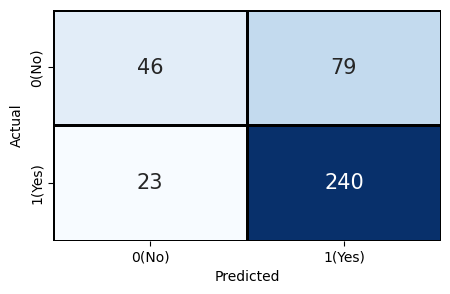

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

#### Edges Index 지수변환 데이터 랜덤포레스트, 로지스틱

In [ ]:
from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler

x = df_clear_exp
y = df_target1["Type"]

# 스케일링
scaler = StandardScaler()
x_scaler = scaler.fit_transform(x)
x_scaler = pd.DataFrame(x_scaler, columns=x.columns)

# 훈련
x_train_exp1, x_test_exp1, y_train_exp1, y_test_exp1 = train_test_split(x_scaler, y, test_size=0.2)
# encoder = LabelEncoder()
# y_train, y_test = encoder.fit_transform(y_train), encoder.fit_transform(y_test)
x_train_exp1.shape, x_test_exp1.shape, y_train_exp1.shape, y_test_exp1.shape

((1552, 20), (388, 20), (1552,), (388,))

In [ ]:
import time

model_rf = RandomForestClassifier()
start_time = time.time()
model_rf.fit(x_train_exp1, y_train_exp1)
end_time= time.time()
rf_precision_train, rf_recall_train, rf_accuracy_train, rf_f1_train, y_pred = get_metrics(model_rf, x_train_exp1, y_train_exp1)
print('실행시간 : ', end_time - start_time)
print('='*100)
rf_precision_test, rf_recall_test, rf_accuracy_test, rf_f1_test, y_pred = get_metrics(model_rf, x_test_exp1, y_test_exp1)

Precision Score  : 1.0
Recall Score     : 1.0
Accuracy Score   : 1.0
F1 Score         : 1.0
실행시간 :  0.34305810928344727
Precision Score  : 0.8119544602419206
Recall Score     : 0.8144329896907216
Accuracy Score   : 0.8144329896907216
F1 Score         : 0.8128161456677784


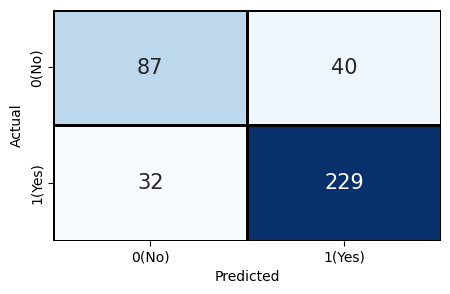

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test_exp1, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

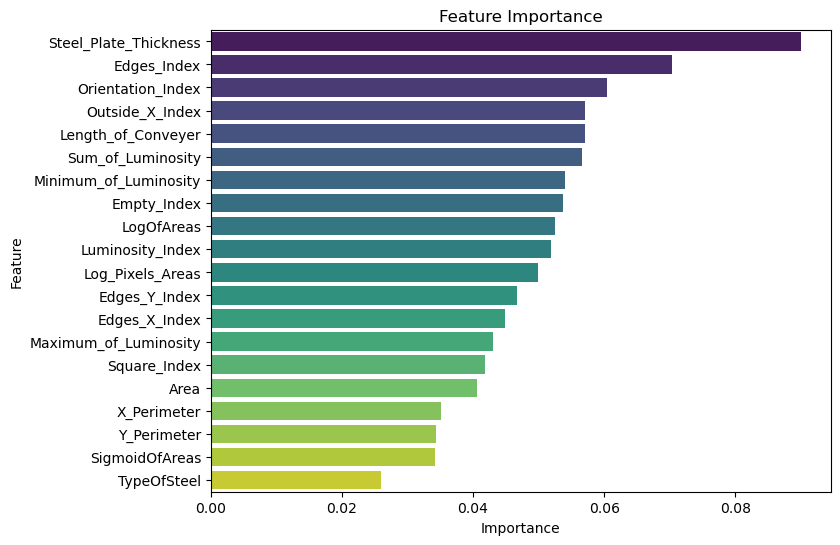

In [ ]:
# 막대 그래프 그리기
plt.figure(figsize=(8, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df, palette='viridis')
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [ ]:
import time
from sklearn.linear_model import LogisticRegression

model_lr = LogisticRegression()
start_time = time.time()
model_lr.fit(x_train_exp1, y_train_exp1)
end_time= time.time()
lr_precision_train, lr_recall_train, lr_accuracy_train, lr_f1_train, y_pred = get_metrics(model_lr, x_train_exp1, y_train_exp1)
print('실행시간 : ', end_time - start_time)
print('='*100)
lr_precision_test, lr_recall_test, lr_accuracy_test, lr_f1_test, y_pred = get_metrics(model_lr, x_test_exp1, y_test_exp1)

Precision Score  : 0.7061221896865364
Recall Score     : 0.7164948453608248
Accuracy Score   : 0.7164948453608248
F1 Score         : 0.6969794890726075
실행시간 :  0.03096175193786621
Precision Score  : 0.7171939727204256
Recall Score     : 0.729381443298969
Accuracy Score   : 0.729381443298969
F1 Score         : 0.7181567827233418


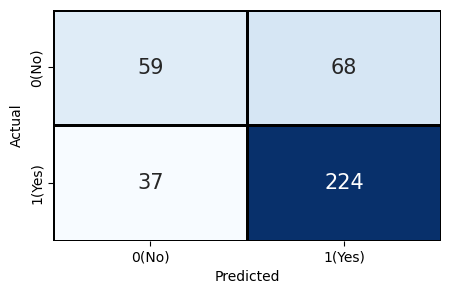

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test_exp1, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

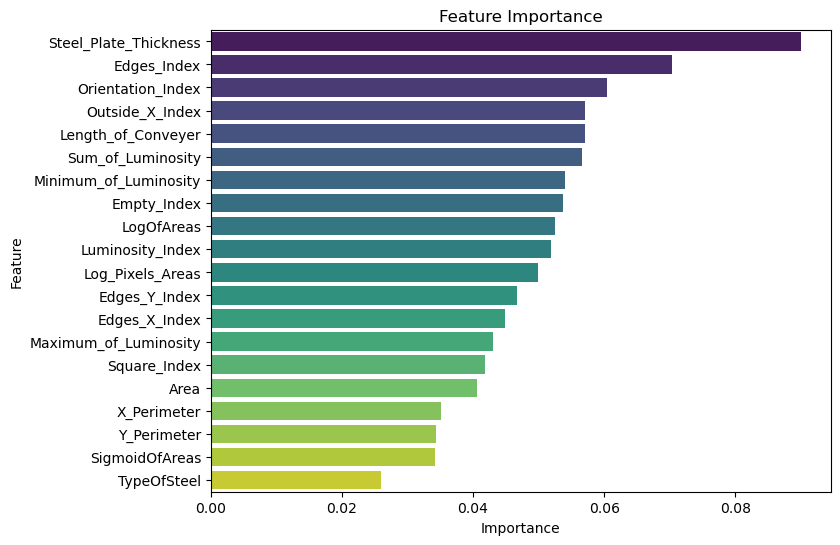

In [ ]:
# 막대 그래프 그리기
plt.figure(figsize=(8, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df, palette='viridis')
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

##### Type of steel 제거해보기

In [ ]:
df_clear2_drop = df_clear2.drop(columns='TypeOfSteel')

In [ ]:
from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler

x = df_clear2_drop
y = df_target1["Type"]

# 스케일링
scaler = StandardScaler()
x_scaler = scaler.fit_transform(x)
x_scaler = pd.DataFrame(x_scaler, columns=x.columns)

# 훈련
x_train, x_test, y_train, y_test = train_test_split(x_scaler, y, test_size=0.2)
# encoder = LabelEncoder()
# y_train, y_test = encoder.fit_transform(y_train), encoder.fit_transform(y_test)
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((1552, 19), (388, 19), (1552,), (388,))

In [ ]:
import time

model_rf = RandomForestClassifier()
start_time = time.time()
model_rf.fit(x_train, y_train)
end_time= time.time()
rf_precision_train, rf_recall_train, rf_accuracy_train, rf_f1_train, y_pred = get_metrics(model_rf, x_train, y_train)
print('실행시간 : ', end_time - start_time)
print('='*100)
rf_precision_test, rf_recall_test, rf_accuracy_test, rf_f1_test, y_pred = get_metrics(model_rf, x_test, y_test)

Precision Score  : 1.0
Recall Score     : 1.0
Accuracy Score   : 1.0
F1 Score         : 1.0
실행시간 :  0.3690149784088135
Precision Score  : 0.7971182566599017
Recall Score     : 0.7989690721649485
Accuracy Score   : 0.7989690721649485
F1 Score         : 0.7926400376308259


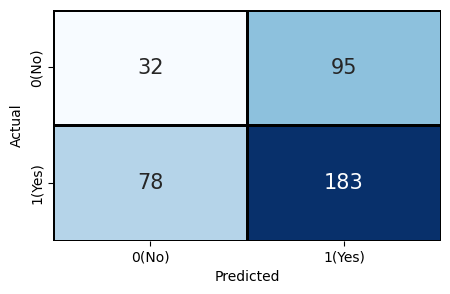

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test_exp1, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
importances = model_rf.feature_importances_
importance_df = pd.DataFrame({'Feature': x_train.columns, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

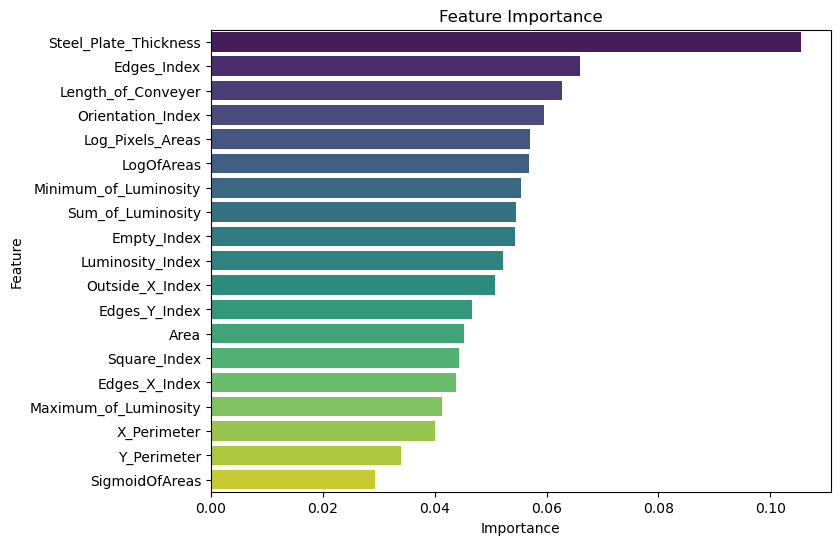

In [ ]:
# 막대 그래프 그리기
plt.figure(figsize=(8, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df, palette='viridis')
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [ ]:
import time
from sklearn.linear_model import LogisticRegression

model_lr = LogisticRegression()
start_time = time.time()
model_lr.fit(x_train, y_train)
end_time= time.time()
lr_precision_train, lr_recall_train, lr_accuracy_train, lr_f1_train, y_pred = get_metrics(model_lr, x_train, y_train)
print('실행시간 : ', end_time - start_time)
print('='*100)
lr_precision_test, lr_recall_test, lr_accuracy_test, lr_f1_test, y_pred = get_metrics(model_lr, x_test, y_test)

Precision Score  : 0.7237042945484307
Recall Score     : 0.7313144329896907
Accuracy Score   : 0.7313144329896907
F1 Score         : 0.7084305584590498
실행시간 :  0.03099966049194336
Precision Score  : 0.6804514992056225
Recall Score     : 0.6932989690721649
Accuracy Score   : 0.6932989690721649
F1 Score         : 0.6734444337361614


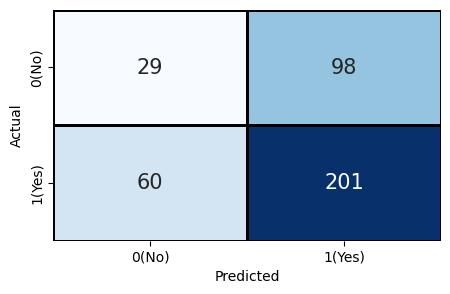

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test_exp1, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

### 다중분류

In [ ]:
x2 = df_clear3
y2 = df_target2["Type"]

# 스케일링
scaler2 = StandardScaler()
x_scaler2 = scaler.fit_transform(x2)
x_scaler2 = pd.DataFrame(x_scaler2, columns=x2.columns)

# 훈련
x_train2, x_test2, y_train2, y_test2 = train_test_split(x_scaler2, y2, test_size=0.2)
encoder = LabelEncoder()
y_train2, y_test2 = encoder.fit_transform(y_train2), encoder.fit_transform(y_test2)
x_train2.shape, x_test2.shape, y_train2.shape, y_test2.shape

((1013, 20), (254, 20), (1013,), (254,))

In [ ]:
model_rf2 = RandomForestClassifier()
start_time = time.time()
model_rf2.fit(x_train2, y_train2)
end_time= time.time()
rf_precision_train2, rf_recall_train2, rf_accuracy_train2, rf_f1_train2, y_pred = get_metrics(model_rf2, x_train2, y_train2)
print('실행시간 : ', end_time - start_time)
print('='*100)
rf_precision_test2, rf_recall_test2, rf_accuracy_test2, rf_f1_test2, y_pred = get_metrics(model_rf2, x_test2, y_test2)

Precision Score  : 1.0
Recall Score     : 1.0
Accuracy Score   : 1.0
F1 Score         : 1.0
실행시간 :  0.20817255973815918
Precision Score  : 0.9372415338326611
Recall Score     : 0.937007874015748
Accuracy Score   : 0.937007874015748
F1 Score         : 0.936246839404094


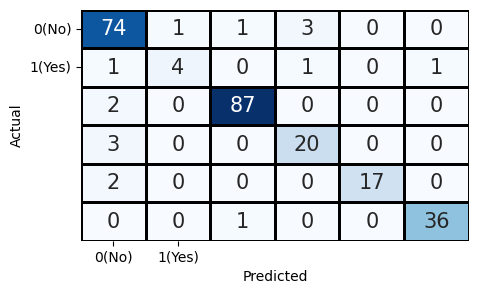

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test2, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test2, y_pred))

              precision    recall  f1-score   support

           0       0.90      0.94      0.92        79
           1       0.80      0.57      0.67         7
           2       0.98      0.98      0.98        89
           3       0.83      0.87      0.85        23
           4       1.00      0.89      0.94        19
           5       0.97      0.97      0.97        37

    accuracy                           0.94       254
   macro avg       0.91      0.87      0.89       254
weighted avg       0.94      0.94      0.94       254



In [ ]:
importances2 = model_rf2.feature_importances_
importance_df2 = pd.DataFrame({'Feature': x_train2.columns, 'Importance': importances2})
importance_df2 = importance_df2.sort_values(by='Importance', ascending=False)

In [ ]:
importance_df2

,Feature,Importance
5,Length_of_Conveyer,0.106894
7,Steel_Plate_Thickness,0.076685
2,Sum_of_Luminosity,0.076623
11,Outside_X_Index,0.070120
14,LogOfAreas,0.064648
15,Orientation_Index,0.059757
18,Log_Pixels_Areas,0.058931
10,Square_Index,0.048559
3,Minimum_of_Luminosity,0.045057
19,Area,0.044857


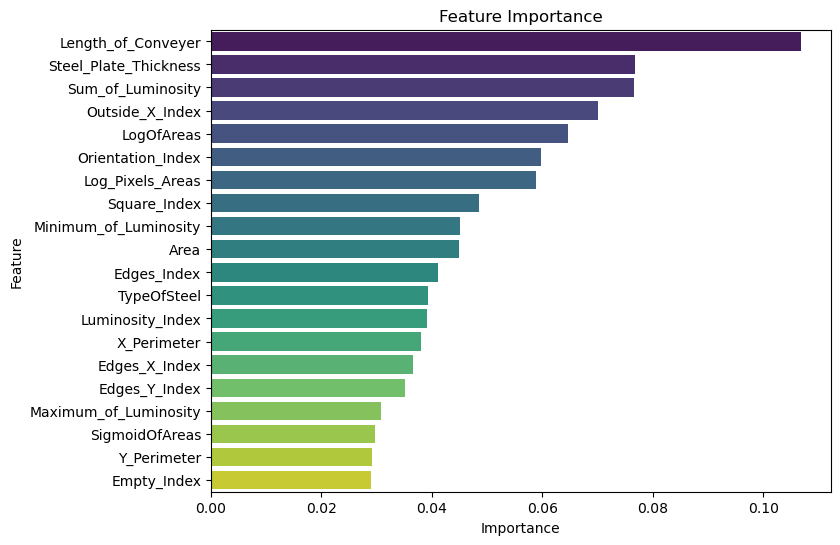

In [ ]:
# 막대 그래프 그리기
plt.figure(figsize=(8, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df2, palette='viridis')
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [ ]:
importance_df = importance_df.reset_index(drop=True)
importance_df2 = importance_df2.reset_index(drop=True)

# importance_df와 importance_df2 합치기 (ignore_index=False 옵션 사용)
all_importances = pd.concat([importance_df, importance_df2], ignore_index=False, axis=1)

# 컬럼명 변경 (중복된 컬럼 이름 변경)
all_importances.columns = ['Feature1', 'Importance1', 'Feature2', 'Importance2']

print(all_importances)

                 Feature1  Importance1               Feature2  Importance2
0   Steel_Plate_Thickness     0.105560     Length_of_Conveyer     0.106894
1             Edges_Index     0.065985  Steel_Plate_Thickness     0.076685
2      Length_of_Conveyer     0.062785      Sum_of_Luminosity     0.076623
3       Orientation_Index     0.059531        Outside_X_Index     0.070120
4        Log_Pixels_Areas     0.057126             LogOfAreas     0.064648
5              LogOfAreas     0.056933      Orientation_Index     0.059757
6   Minimum_of_Luminosity     0.055372       Log_Pixels_Areas     0.058931
7       Sum_of_Luminosity     0.054556           Square_Index     0.048559
8             Empty_Index     0.054320  Minimum_of_Luminosity     0.045057
9        Luminosity_Index     0.052192                   Area     0.044857
10        Outside_X_Index     0.050805            Edges_Index     0.041042
11          Edges_Y_Index     0.046700            TypeOfSteel     0.039268
12                   Area

In [ ]:
df_clear2.to_csv('df_clear2', index=False)
df_clear3.to_csv('df_clear3', index=False)
df_clear_exp.to_csv('df_clear_exp', index=False)

In [ ]:
# 다중분류를 위한 'Type' 컬럼 값 수정
df_target2 = df_target.copy()
# 'Other_Faults'를 제외한 인덱스 가져오기
indices_to_remove = df_target2[df_target2['Type'] == 'Other_Faults'].index
# 해당 인덱스들을 제거하여 새로운 데이터프레임 생성
df_clear3 = df_clear_exp.copy()
df_clear3 = df_clear3.drop(indices_to_remove)
# 'Other_Faults' 행을 제외하고 결함이 있는 것만 남기기
df_target2 = df_target2[df_target2['Type'] != 'Other_Faults']
df_target2['Type'].value_counts(normalize=True)

Bumps        0.317285
K_Scatch     0.307814
Z_Scratch    0.149961
Pastry       0.124704
Stains       0.056827
Dirtiness    0.043410
Name: Type, dtype: float64

In [ ]:
import time
from sklearn.linear_model import LogisticRegression

model_lr = LogisticRegression()
start_time = time.time()
model_lr.fit(x_train2, y_train2)
end_time= time.time()
lr_precision_train, lr_recall_train, lr_accuracy_train, lr_f1_train, y_pred = get_metrics(model_lr, x_train2, y_train2)
print('실행시간 : ', end_time - start_time)
print('='*100)
lr_precision_test, lr_recall_test, lr_accuracy_test, lr_f1_test, y_pred = get_metrics(model_lr, x_test2, y_test2)

Precision Score  : 0.8666206671680198
Recall Score     : 0.8677196446199408
Accuracy Score   : 0.8677196446199408
F1 Score         : 0.8669641028805257
실행시간 :  0.04197239875793457
Precision Score  : 0.8868223402612847
Recall Score     : 0.8858267716535433
Accuracy Score   : 0.8858267716535433
F1 Score         : 0.8822457533236818


c:\Users\born9\anaconda3\envs\Abal\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


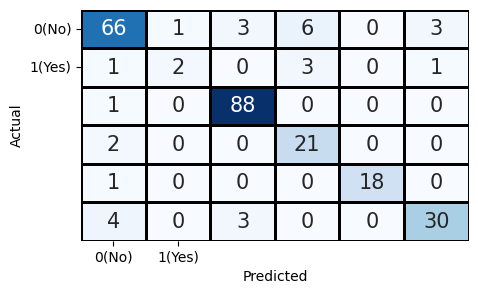

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test2, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test2, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.84      0.86        79
           1       0.67      0.29      0.40         7
           2       0.94      0.99      0.96        89
           3       0.70      0.91      0.79        23
           4       1.00      0.95      0.97        19
           5       0.88      0.81      0.85        37

    accuracy                           0.89       254
   macro avg       0.84      0.80      0.80       254
weighted avg       0.89      0.89      0.88       254



In [ ]:
import time

model_svc = SVC(kernel='poly')
start_time = time.time()
model_svc.fit(x_train2, y_train2)
end_time= time.time()
lr_precision_train, lr_recall_train, lr_accuracy_train, lr_f1_train, y_pred = get_metrics(model_svc, x_train2, y_train2)
print('실행시간 : ', end_time - start_time)
print('='*100)
lr_precision_test, lr_recall_test, lr_accuracy_test, lr_f1_test, y_pred = get_metrics(model_svc, x_test2, y_test2)

Precision Score  : 0.8901406012219871
Recall Score     : 0.8647581441263573
Accuracy Score   : 0.8647581441263573
F1 Score         : 0.8642619606818037
실행시간 :  0.011999368667602539
Precision Score  : 0.8827099995338867
Recall Score     : 0.8700787401574803
Accuracy Score   : 0.8700787401574803
F1 Score         : 0.8669715670827196


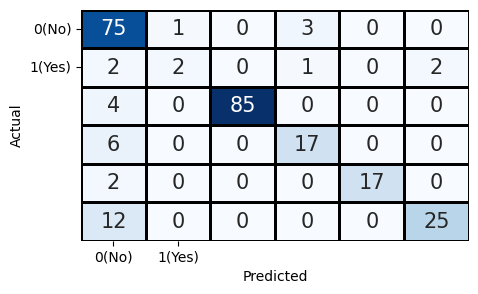

In [ ]:
from sklearn.metrics import confusion_matrix

plt.figure(figsize = (5, 3))
sns.heatmap(confusion_matrix(y_test2, y_pred), cmap = 'Blues',
            cbar = False, annot = True, annot_kws = {'size' : 15},
            fmt = '.0f', xticklabels = ['0(No)', '1(Yes)'], yticklabels = ['0(No)', '1(Yes)'],
            linecolor = 'k', linewidths = 0.8)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test2, y_pred))

              precision    recall  f1-score   support

           0       0.74      0.95      0.83        79
           1       0.67      0.29      0.40         7
           2       1.00      0.96      0.98        89
           3       0.81      0.74      0.77        23
           4       1.00      0.89      0.94        19
           5       0.93      0.68      0.78        37

    accuracy                           0.87       254
   macro avg       0.86      0.75      0.78       254
weighted avg       0.88      0.87      0.87       254

